In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

#to ignore warnings
import warnings
warnings.filterwarnings('ignore')

### Exploratory Data Analysis - EDA

#### Import The Data

In [3]:
df=pd.read_csv("Walmart dataset.csv", encoding='ISO-8859-1') ##, index_col='Date', parse_dates=True)
df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...,...
6430,45,28-09-2012,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,05-10-2012,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,12-10-2012,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,19-10-2012,718125.53,0,56.47,3.969,192.330854,8.667


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


In [3]:
df.columns

Index(['Store', 'Date', 'Weekly_Sales', 'Holiday_Flag', 'Temperature',
       'Fuel_Price', 'CPI', 'Unemployment'],
      dtype='object')

In [4]:
df.columns = df.columns.str.replace("_",".")
df.columns

Index(['Store', 'Date', 'Weekly.Sales', 'Holiday.Flag', 'Temperature',
       'Fuel.Price', 'CPI', 'Unemployment'],
      dtype='object')

### Data Type Standardization

In [5]:
from datetime import datetime, date 

df['Date'] = pd.to_datetime(df['Date'], format = '%d-%m-%Y')
df.head().style.set_properties(subset=['Date'], **{'background-color': 'dodgerblue'})

,Store,Date,Weekly.Sales,Holiday.Flag,Temperature,Fuel.Price,CPI,Unemployment
0,1,2010-02-05 00:00:00,1643690.900000,0,42.310000,2.572000,211.096358,8.106000
1,1,2010-02-12 00:00:00,1641957.440000,1,38.510000,2.548000,211.242170,8.106000
2,1,2010-02-19 00:00:00,1611968.170000,0,39.930000,2.514000,211.289143,8.106000
3,1,2010-02-26 00:00:00,1409727.590000,0,46.630000,2.561000,211.319643,8.106000
4,1,2010-03-05 00:00:00,1554806.680000,0,46.500000,2.625000,211.350143,8.106000


#### Number of records in the data and the distribution 

In [6]:
df.shape

(6435, 8)

### Check for missing values 

In [7]:
df.isna().sum()

Store           0
Date            0
Weekly.Sales    0
Holiday.Flag    0
Temperature     0
Fuel.Price      0
CPI             0
Unemployment    0
dtype: int64

In [8]:
df.isnull().sum()

Store           0
Date            0
Weekly.Sales    0
Holiday.Flag    0
Temperature     0
Fuel.Price      0
CPI             0
Unemployment    0
dtype: int64

#### Data Distribution 

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Store,6435.0,2.300000e+01,12.988182,1.000,12.000,23.000000,3.400000e+01,4.500000e+01
Weekly.Sales,6435.0,1.046965e+06,564366.622054,209986.250,553350.105,960746.040000,1.420159e+06,3.818686e+06
Holiday.Flag,6435.0,6.993007e-02,0.255049,0.000,0.000,0.000000,0.000000e+00,1.000000e+00
Temperature,6435.0,6.066378e+01,18.444933,-2.060,47.460,62.670000,7.494000e+01,1.001400e+02
Fuel.Price,6435.0,3.358607e+00,0.459020,2.472,2.933,3.445000,3.735000e+00,4.468000e+00
CPI,6435.0,1.715784e+02,39.356712,126.064,131.735,182.616521,2.127433e+02,2.272328e+02
Unemployment,6435.0,7.999151e+00,1.875885,3.879,6.891,7.874000,8.622000e+00,1.431300e+01


In [10]:
df.nunique()

Store             45
Date             143
Weekly.Sales    6435
Holiday.Flag       2
Temperature     3528
Fuel.Price       892
CPI             2145
Unemployment     349
dtype: int64

### Distribution Analysis

In [11]:
1%3

1

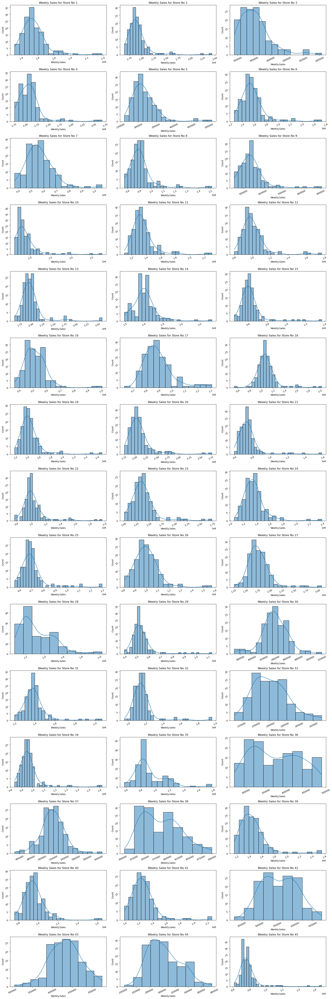

In [12]:
fig,ax =  plt.subplots(15, 3, figsize=(20,60))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):
    y_pos = (store-1)%3
    if(y_pos==0):
        x_pos=x_pos+1

    sns.histplot(df[df['Store']==store]['Weekly.Sales'], kde=True, ax = ax[x_pos][y_pos]).set(title='Weekly Sales for Store No '+ str(store))
 
    ax[x_pos][y_pos].tick_params(labelrotation = 25)
    fig.tight_layout(pad = 1.1)

### Correlation Analysis

In [13]:
df.corr()

,Store,Weekly.Sales,Holiday.Flag,Temperature,Fuel.Price,CPI,Unemployment
Store,1.000000e+00,-0.335332,-4.386841e-16,-0.022659,0.060023,-0.209492,0.223531
Weekly.Sales,-3.353320e-01,1.000000,3.689097e-02,-0.063810,0.009464,-0.072634,-0.106176
Holiday.Flag,-4.386841e-16,0.036891,1.000000e+00,-0.155091,-0.078347,-0.002162,0.010960
Temperature,-2.265908e-02,-0.063810,-1.550913e-01,1.000000,0.144982,0.176888,0.101158
Fuel.Price,6.002295e-02,0.009464,-7.834652e-02,0.144982,1.000000,-0.170642,-0.034684
CPI,-2.094919e-01,-0.072634,-2.162091e-03,0.176888,-0.170642,1.000000,-0.302020
Unemployment,2.235313e-01,-0.106176,1.096028e-02,0.101158,-0.034684,-0.302020,1.000000


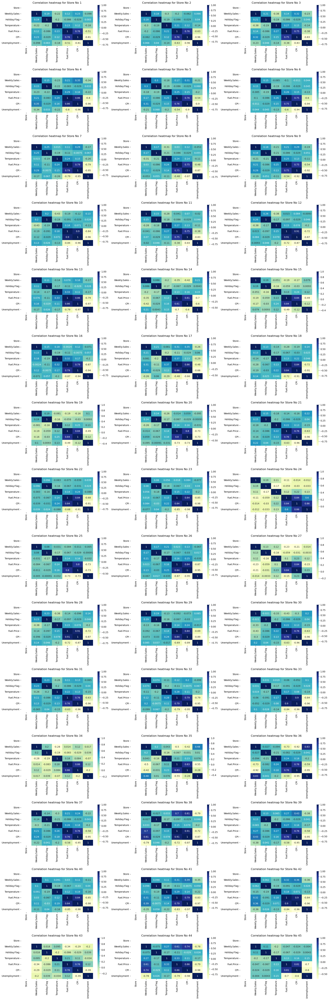

In [14]:
fig,ax =  plt.subplots(15, 3, figsize=(20,60))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):
    y_pos = (store-1)%3
    if(y_pos==0):
        x_pos=x_pos+1
        
    sns.heatmap(df[df['Store']==store].corr(), cmap='YlGnBu', ax = ax[x_pos][y_pos], annot=True).set(title='Correlation heatmap for Store No '+ str(store))
    
    fig.tight_layout(pad = 1.2)   

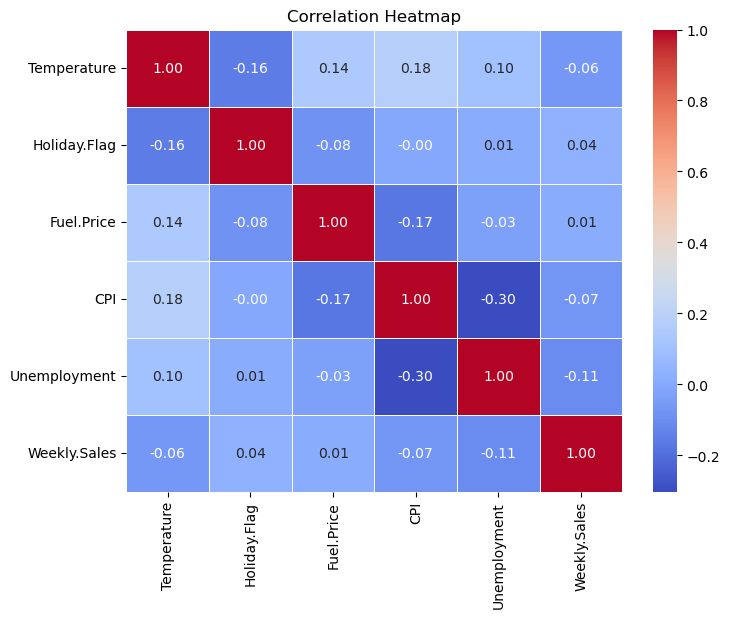

In [15]:
# Displaying the correlation of the independent features with the target variable
import seaborn as sns
independent_variables = ['Temperature','Holiday.Flag', 'Fuel.Price', 'CPI', 'Unemployment']

# Calculate the correlation matrix
correlation_matrix = df[independent_variables + ['Weekly.Sales']].corr()

# Create a heatmap to visualize the correlations
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()


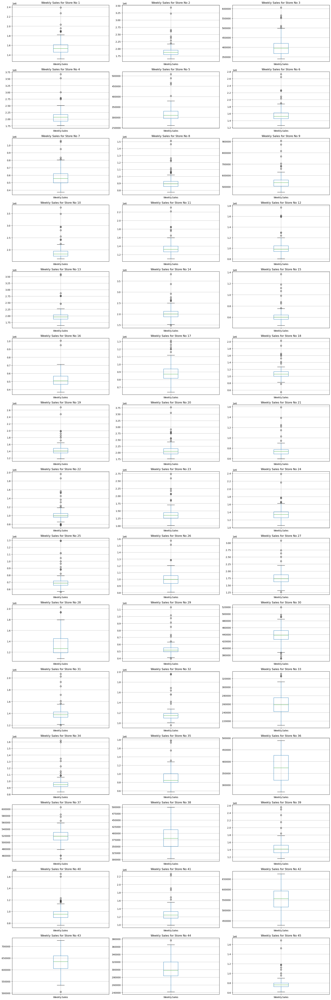

In [16]:
fig,ax =  plt.subplots(15, 3, figsize=(20,60))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):
    y_pos = (store-1)%3
    if(y_pos==0):
        x_pos=x_pos+1

    df[df['Store']==store].boxplot(column = ['Weekly.Sales'], ax = ax[x_pos][y_pos]).set(title='Weekly Sales for Store No '+ str(store))
#    b_plot.plot()
#    plot.show()
    
    fig.tight_layout(pad = 1.2)

<AxesSubplot:xlabel='Store', ylabel='Weekly.Sales'>

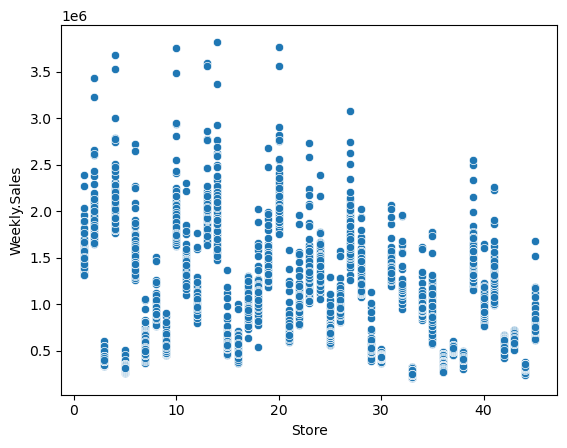

In [17]:
sns.scatterplot(x = 'Store', y = 'Weekly.Sales', data = df)

A> Relationship between Weekly Sales and Unemployment Rate:

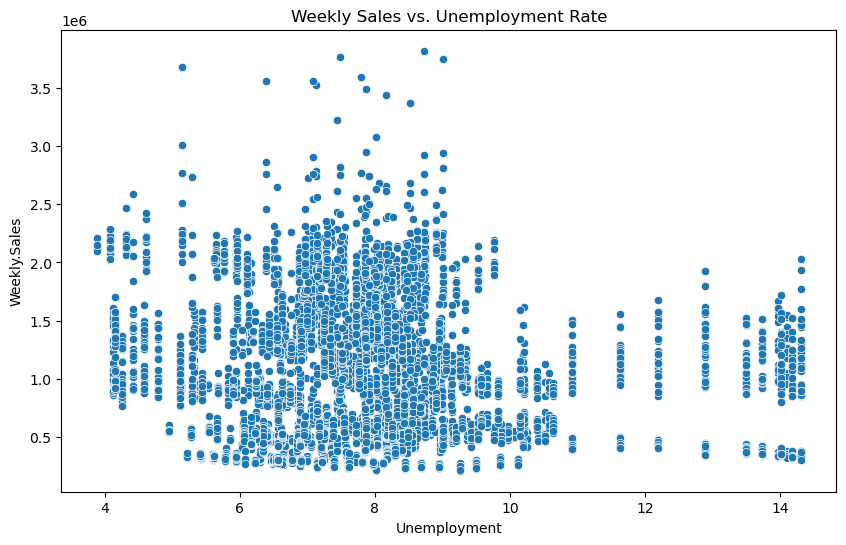

In [18]:
# Scatter plot of Weekly Sales vs. Unemployment Rate
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Unemployment', y='Weekly.Sales', data=df)
plt.title('Weekly Sales vs. Unemployment Rate')
plt.show()

In [19]:
# Calculate the correlation matrix
corr_matrix = df[['Store', 'Unemployment', 'Weekly.Sales']].corr()

# Extract the correlation coefficients between Weekly Sales and Unemployment Rate
corr_sales_unemployment = corr_matrix.loc['Weekly.Sales', 'Unemployment']

# Sort the stores based on the correlation coefficient
stores_sorted = df.groupby('Store')['Unemployment', 'Weekly.Sales'].corr().loc[:, 'Unemployment'].sort_values(ascending=False)

# Print the stores suffering the most
print("Stores suffering the most based on correlation with Unemployment Rate:")
print(stores_sorted.head())

Stores suffering the most based on correlation with Unemployment Rate:
Store              
1      Unemployment    1.0
13     Unemployment    1.0
14     Unemployment    1.0
15     Unemployment    1.0
32     Unemployment    1.0
Name: Unemployment, dtype: float64


B> Seasonal Trend in Weekly Sales:

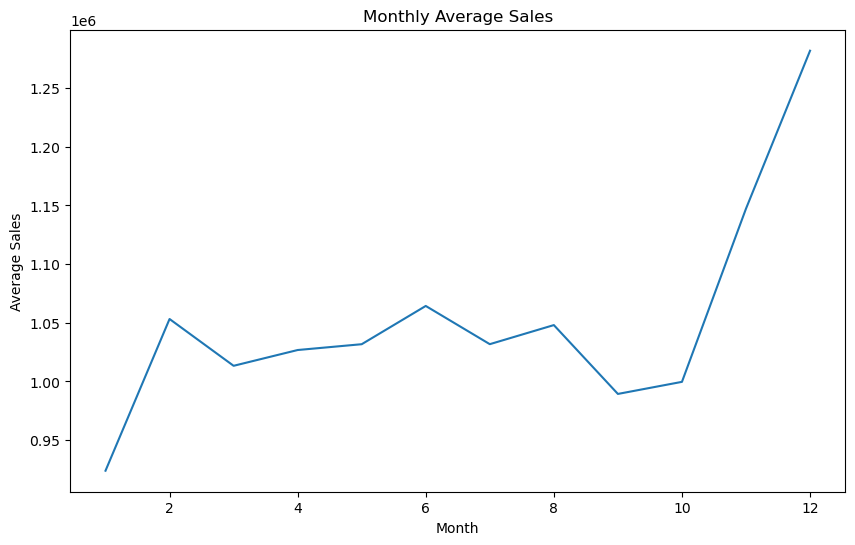

In [20]:
# Convert the 'Date' column to datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Extract the month from the 'Date' column
df['Month'] = df['Date'].dt.month

# Compute the average Weekly Sales for each month
monthly_sales = df.groupby('Month')['Weekly.Sales'].mean()

# Plot the monthly average sales
plt.figure(figsize=(10, 6))
sns.lineplot(x=monthly_sales.index, y=monthly_sales.values)
plt.title('Monthly Average Sales')
plt.xlabel('Month')
plt.ylabel('Average Sales')
plt.show()

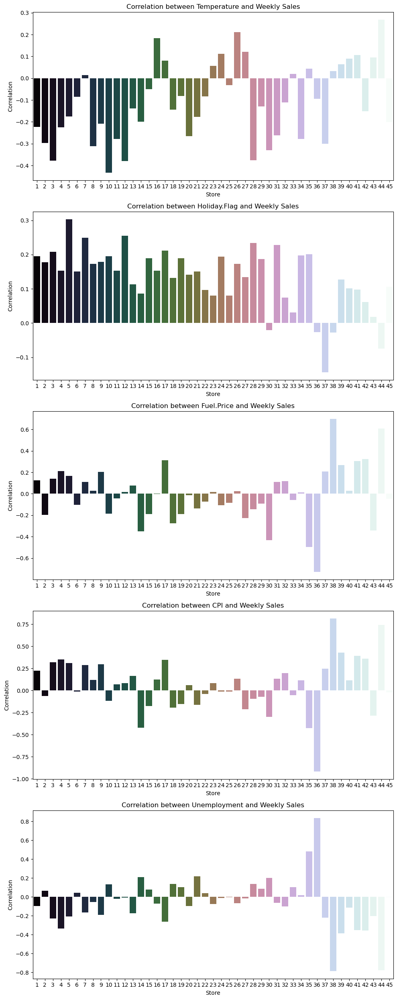

In [21]:
# Assuming you have selected independent variables (features) of interest
# Replace the column names below with your actual feature names
independent_variables = ['Temperature','Holiday.Flag','Fuel.Price', 'CPI', 'Unemployment']

# Create subplots for each independent variable
num_variables = len(independent_variables)
fig, axes = plt.subplots(num_variables, figsize=(10, 5 * num_variables))

# Calculate and plot correlations for each independent variable across all stores
for variable, ax in zip(independent_variables, axes):
    correlations = df.groupby('Store')[[variable, 'Weekly.Sales']].corr().iloc[0::2, -1].reset_index()

    sns.barplot(data=correlations, x='Store', y='Weekly.Sales', ax=ax, palette='cubehelix')
    ax.set_title(f'Correlation between {variable} and Weekly Sales')
    ax.set_xlabel('Store')
    ax.set_ylabel('Correlation')

plt.tight_layout()
plt.show()

C> Relationship between Temperature and Weekly sales:

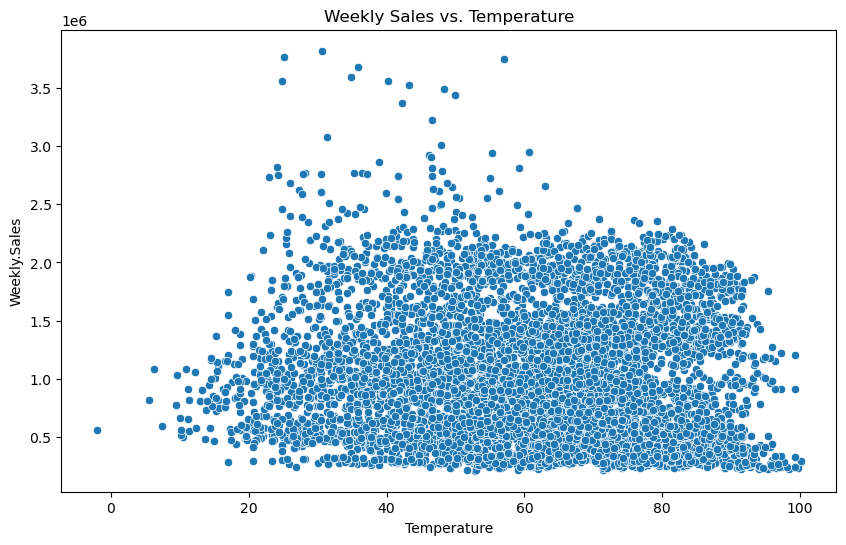

In [22]:
# Scatter plot of Weekly Sales vs. Temperature
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Temperature', y='Weekly.Sales', data=df)
plt.title('Weekly Sales vs. Temperature')
plt.show()


D> Reationship between Consumer Price Index (CPI) and Weekly Sales:

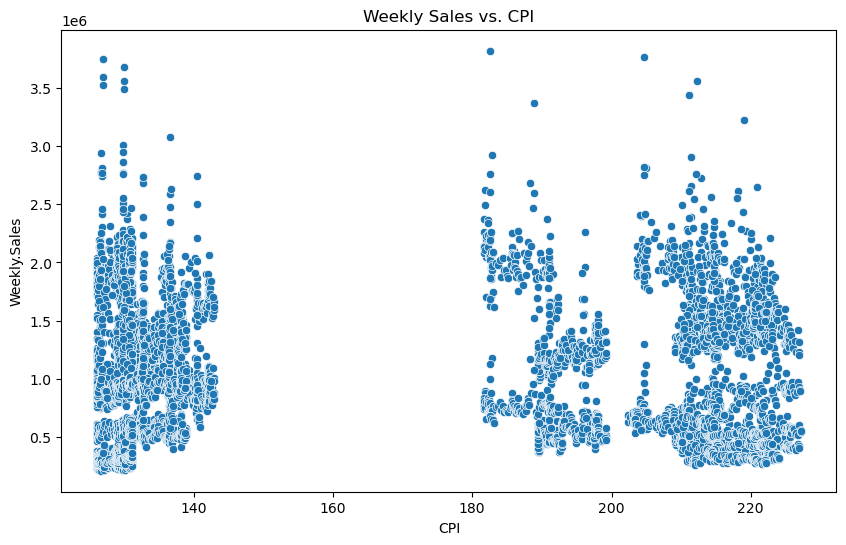

In [23]:
# Scatter plot of Weekly Sales vs. CPI
plt.figure(figsize=(10, 6))
sns.scatterplot(x='CPI', y='Weekly.Sales', data=df)
plt.title('Weekly Sales vs. CPI')
plt.show()

E> Top Performing Stores: 

In [24]:
# Compute the total sales for each store
total_sales = df.groupby('Store')['Weekly.Sales'].sum()

# Sort the stores based on total sales
top_stores = total_sales.sort_values(ascending=False).head()

# Print the top performing stores
print("Top Performing Stores:")
print(top_stores)

Top Performing Stores:
Store
20    3.013978e+08
4     2.995440e+08
14    2.889999e+08
13    2.865177e+08
2     2.753824e+08
Name: Weekly.Sales, dtype: float64


F> Worst performing stores:

In [25]:
# Sort the stores based on total sales
worst_store = total_sales.sort_values().head()

# Print the worst performing stores
print("Worst Performing Stores:")
print(worst_store)

Worst Performing Stores:
Store
33    37160221.96
44    43293087.84
5     45475688.90
36    53412214.97
38    55159626.42
Name: Weekly.Sales, dtype: float64


<AxesSubplot:xlabel='Store', ylabel='Weekly.Sales'>

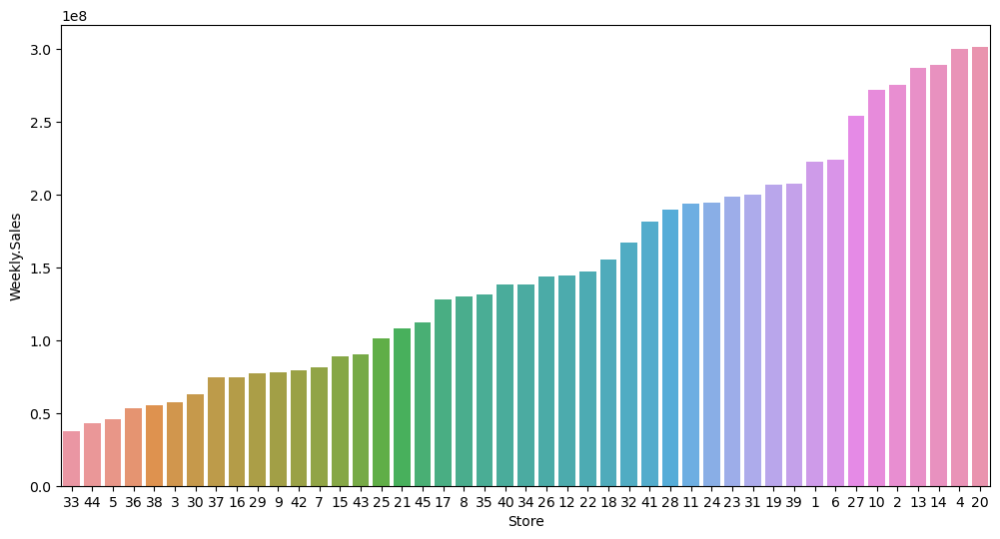

In [26]:
sumdf = pd.DataFrame(df.groupby('Store')['Weekly.Sales'].sum().sort_values())

plt.figure(figsize=(12, 6))
sns.barplot(data=sumdf, y='Weekly.Sales', x=sumdf.index, order=sumdf.index)

In [27]:
df.groupby('Store')['Weekly.Sales'].sum().sort_values()

Store
33    3.716022e+07
44    4.329309e+07
5     4.547569e+07
36    5.341221e+07
38    5.515963e+07
3     5.758674e+07
30    6.271689e+07
37    7.420274e+07
16    7.425243e+07
29    7.714155e+07
9     7.778922e+07
42    7.956575e+07
7     8.159828e+07
15    8.913368e+07
43    9.056544e+07
25    1.010612e+08
21    1.081179e+08
45    1.123953e+08
17    1.277821e+08
8     1.299512e+08
35    1.315207e+08
40    1.378703e+08
34    1.382498e+08
26    1.434164e+08
12    1.442872e+08
22    1.470756e+08
18    1.551147e+08
32    1.668192e+08
41    1.813419e+08
28    1.892637e+08
11    1.939628e+08
24    1.940160e+08
23    1.987506e+08
31    1.996139e+08
19    2.066349e+08
39    2.074455e+08
1     2.224028e+08
6     2.237561e+08
27    2.538559e+08
10    2.716177e+08
2     2.753824e+08
13    2.865177e+08
14    2.889999e+08
4     2.995440e+08
20    3.013978e+08
Name: Weekly.Sales, dtype: float64

## Additional Detailed Analysis

In [28]:
print("**************CPI*****************")
print("Store", "Corr")
for store in range(1,46):
    corr = df[df['Store']==store]['Weekly.Sales'].corr(df[df['Store']==store]['CPI'])
    if (corr > 0.3) or (corr < -0.3):
        print(store, corr)

print("********************Unemployment**********************")
print("Store", "Corr")
for store in range(1,46):
    corr = df[df['Store']==store]['Weekly.Sales'].corr(df[df['Store']==store]['Unemployment'])
    if (corr > 0.3) or (corr < -0.3):
        print(store, corr)

print("**********************Fuel.Price**********************")
print("Store", "Corr")
for store in range(1,46):
    corr = df[df['Store']==store]['Weekly.Sales'].corr(df[df['Store']==store]['Fuel.Price'])
    if (corr > 0.3) or (corr < -0.3):
        print(store, corr)

print("******************Holiday.Flag******************")
print("Store", "Corr")
for store in range(1,46):
    corr = df[df['Store']==store]['Weekly.Sales'].corr(df[df['Store']==store]['Holiday.Flag'])
    if (corr > 0.3) or (corr < -0.3):
        print(store, corr)

**************CPI*****************
Store Corr
3 0.31724963399858214
4 0.35115723812788213
5 0.3082612991681616
14 -0.41975479220453016
17 0.3485711731503007
35 -0.4241071564963808
36 -0.9150952776725552
38 0.8128368242188552
39 0.42804310982667837
41 0.39229293576731084
42 0.360858946075142
44 0.7401498169960987
********************Unemployment**********************
Store Corr
4 -0.3370151956445587
35 0.4838654198192479
36 0.8337336178415085
38 -0.7852902748572028
39 -0.38468135708616064
41 -0.3506296095634573
42 -0.3563546441574805
44 -0.7800764432910237
**********************Fuel.Price**********************
Store Corr
14 -0.35034010968552887
17 0.31163087301608816
30 -0.43144104945204675
35 -0.4981968990335081
36 -0.7274618540899406
38 0.6971840519774521
41 0.30574452498883825
42 0.32303128422999783
43 -0.34203665217155865
44 0.6073673757269534
******************Holiday.Flag******************
Store Corr
5 0.3025247041761125


==================Unemployment=========================
Store Corr
3 -0.2304130134863526
4 -0.3370151956445587
5 -0.20704271031605842
14 0.2107864829459358
17 -0.26359968183073906
21 0.21836733305703376
30 0.20186223641523895
35 0.4838654198192479
36 0.8337336178415085
37 -0.22128669565468617
38 -0.7852902748572028
39 -0.38468135708616064
41 -0.3506296095634573
42 -0.3563546441574805
43 -0.20195435737205705
44 -0.7800764432910237


<AxesSubplot:xlabel='Store'>

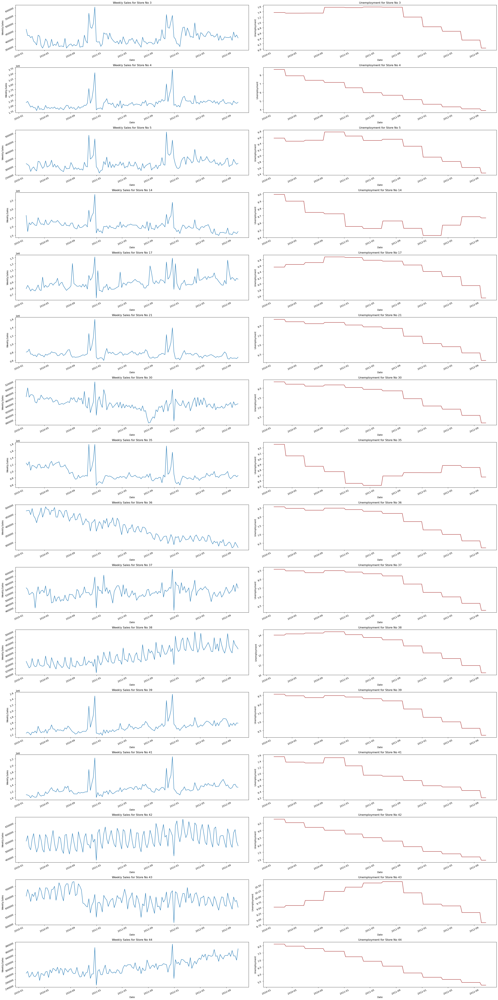

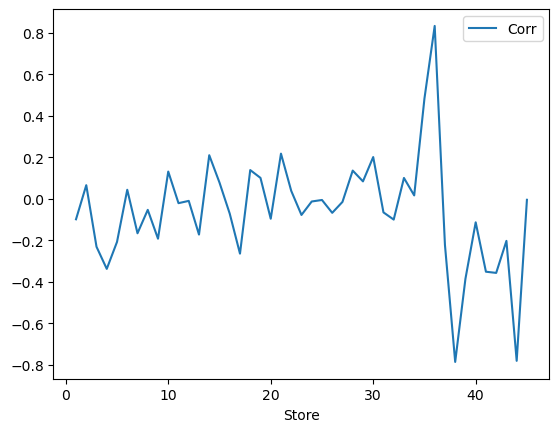

In [38]:
#store_unemp=pd.DataFrame('Store','Corr') 
df_corr=pd.DataFrame()
store_num = []
corr_val = []
fig,ax =  plt.subplots(16, 2, figsize=(30,60))
x_pos=0

print("==================Unemployment=========================")
print("Store", "Corr")
for store in range(1,46):
    corr = df[df['Store']==store]['Weekly.Sales'].corr(df[df['Store']==store]['Unemployment'])
    store_num.append(store)
    corr_val.append(corr)
    if (corr > 0.2) or (corr < -0.2):
        print(store, corr)
        sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][0]).set(title='Weekly Sales for Store No '+ str(store))
        ax[x_pos][0].tick_params(labelrotation = 25)
        sns.lineplot(x = "Date", y = "Unemployment", data = df[df['Store']==store], color='brown', ax = ax[x_pos][1]).set(title='Unemployment for Store No '+ str(store))
        ax[x_pos][1].tick_params(labelrotation = 25)
        x_pos=x_pos+1
        fig.tight_layout(pad = 1.2)


df_corr['Store']=store_num
df_corr['Corr']=corr_val

df_corr.plot('Store', 'Corr')


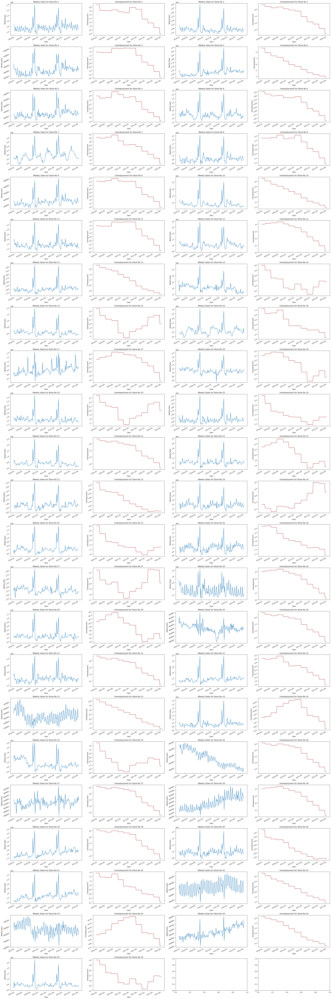

In [29]:
fig,ax =  plt.subplots(23, 4, figsize=(30,90))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):

    if (store % 2):
        x_pos=x_pos+1

        sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][0]).set(title='Weekly Sales for Store No '+ str(store))
        ax[x_pos][0].tick_params(labelrotation = 25)

        sns.lineplot(x = "Date", y = "Unemployment", data = df[df['Store']==store], color='brown', ax = ax[x_pos][1]).set(title='Unemployment for Store No '+ str(store))
        ax[x_pos][1].tick_params(labelrotation = 25)
    
    else:
        sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][2]).set(title='Weekly Sales for Store No '+ str(store))
        ax[x_pos][2].tick_params(labelrotation = 25)

        sns.lineplot(x = "Date", y = "Unemployment", data = df[df['Store']==store], color='brown', ax = ax[x_pos][3]).set(title='Unemployment for Store No '+ str(store))
        ax[x_pos][3].tick_params(labelrotation = 25)
    
    fig.tight_layout(pad = 1.2)

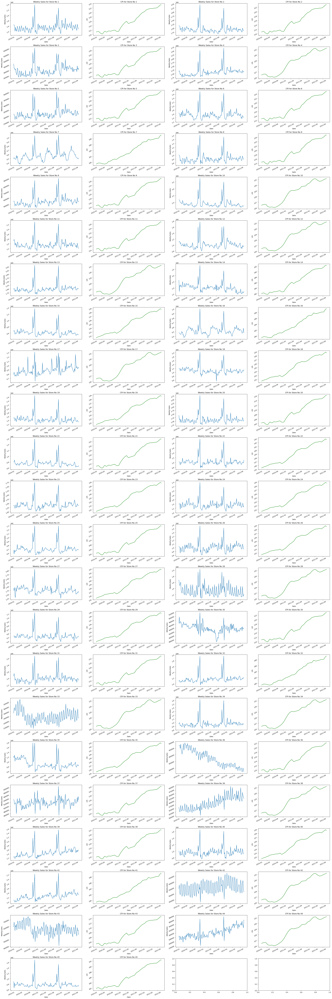

In [30]:
fig,ax =  plt.subplots(23, 4, figsize=(30,90))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):

    if (store % 2):
        x_pos=x_pos+1

        sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][0]).set(title='Weekly Sales for Store No '+ str(store))
        ax[x_pos][0].tick_params(labelrotation = 25)

        sns.lineplot(x = "Date", y = "CPI", data = df[df['Store']==store], color='green', ax = ax[x_pos][1]).set(title='CPI for Store No '+ str(store))
        ax[x_pos][1].tick_params(labelrotation = 25)
    
    else:
        sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][2]).set(title='Weekly Sales for Store No '+ str(store))
        ax[x_pos][2].tick_params(labelrotation = 25)

        sns.lineplot(x = "Date", y = "CPI", data = df[df['Store']==store], color='green', ax = ax[x_pos][3]).set(title='CPI for Store No '+ str(store))
        ax[x_pos][3].tick_params(labelrotation = 25)
    
    fig.tight_layout(pad = 1.2)

In [4]:
features=['Store','Weekly.Sales','Holiday.Flag','Temperature','Fuel.Price','CPI','Unemployment']

In [5]:
features

['Store',
 'Weekly.Sales',
 'Holiday.Flag',
 'Temperature',
 'Fuel.Price',
 'CPI',
 'Unemployment']

### Individual Sales of all the stores 

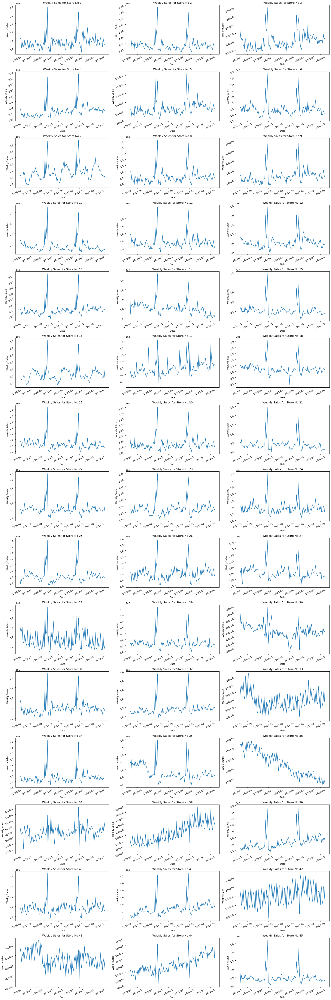

In [33]:
fig,ax =  plt.subplots(15, 3, figsize=(20,60))

#plt.plot(data=df[df['Store']==1],'Weekly.Sales','Temperature')
x_pos=-1
for store in range(1,46):
    y_pos = (store-1)%3
    if(y_pos==0):
        x_pos=x_pos+1

    sns.lineplot(x = "Date", y = "Weekly.Sales", data = df[df['Store']==store], ax = ax[x_pos][y_pos]).set(title='Weekly Sales for Store No '+ str(store))
 
    ax[x_pos][y_pos].tick_params(labelrotation = 25)
    fig.tight_layout(pad = 1.2)

## Time Series Model

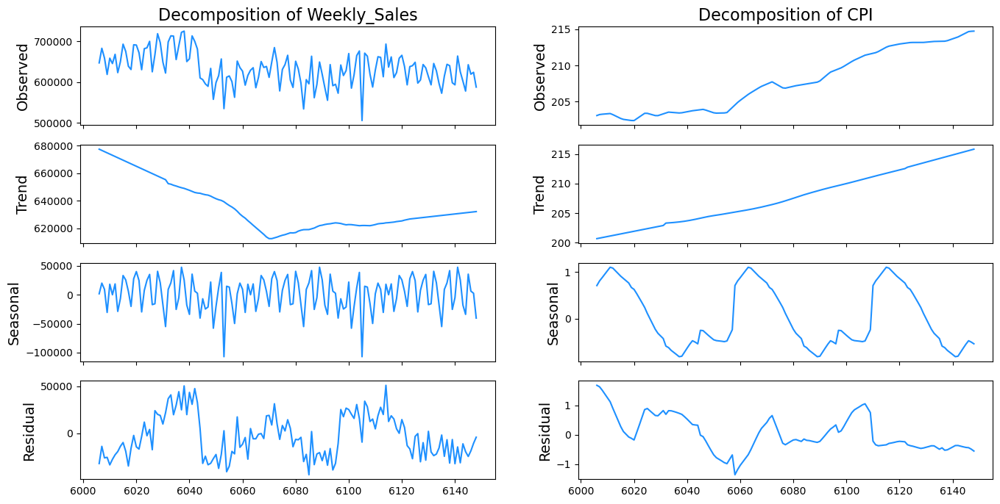

In [13]:
from sklearn.model_selection import TimeSeriesSplit

N_SPLITS = 3

df=pd.read_csv("Walmart dataset.csv") 

X = df[df['Store']==43]['Date']
y = df[df['Store']==43]['Weekly_Sales']

folds = TimeSeriesSplit(n_splits=N_SPLITS)

from statsmodels.tsa.seasonal import seasonal_decompose

core_columns =  ['Store', 'Weekly_Sales', 'Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']

for column in core_columns:
    decomp = seasonal_decompose(df[df['Store']==43][column], period=52, model='additive', extrapolate_trend='freq')
    df[f"{column}_trend"] = decomp.trend
    df[f"{column}_seasonal"] = decomp.seasonal
    
    
fig, ax = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(16,8))

for i, column in enumerate(['Weekly_Sales', 'CPI']):
    
    res = seasonal_decompose(df[df['Store']==43][column], period=52, model='additive', extrapolate_trend='freq')

    ax[0,i].set_title('Decomposition of {}'.format(column), fontsize=16)
    res.observed.plot(ax=ax[0,i], legend=False, color='dodgerblue')
    ax[0,i].set_ylabel('Observed', fontsize=14)

    res.trend.plot(ax=ax[1,i], legend=False, color='dodgerblue')
    ax[1,i].set_ylabel('Trend', fontsize=14)

    res.seasonal.plot(ax=ax[2,i], legend=False, color='dodgerblue')
    ax[2,i].set_ylabel('Seasonal', fontsize=14)
    
    res.resid.plot(ax=ax[3,i], legend=False, color='dodgerblue')
    ax[3,i].set_ylabel('Residual', fontsize=14)

plt.show()

In [14]:
from datetime import datetime, date 

df['Date'] = pd.to_datetime(df['Date'], format = '%d-%m-%Y')
df.head().style.set_properties(subset=['Date'], **{'background-color': 'dodgerblue'})

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Store_trend,Store_seasonal,Weekly_Sales_trend,Weekly_Sales_seasonal,Holiday_Flag_trend,Holiday_Flag_seasonal,Temperature_trend,Temperature_seasonal,Fuel_Price_trend,Fuel_Price_seasonal,CPI_trend,CPI_seasonal,Unemployment_trend,Unemployment_seasonal
0,1,2010-02-05 00:00:00,1643690.900000,0,42.310000,2.572000,211.096358,8.106000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,1,2010-02-12 00:00:00,1641957.440000,1,38.510000,2.548000,211.242170,8.106000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,1,2010-02-19 00:00:00,1611968.170000,0,39.930000,2.514000,211.289143,8.106000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,1,2010-02-26 00:00:00,1409727.590000,0,46.630000,2.561000,211.319643,8.106000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,1,2010-03-05 00:00:00,1554806.680000,0,46.500000,2.625000,211.350143,8.106000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


## Model to Forecast

In [15]:
from statsmodels.tsa.stattools import adfuller

def ad_test(dataset):
    dftest = adfuller(dataset, autolag = 'AIC')
    
    print("1. ADF : ", dftest[0])
    print("2. P-Value : ", dftest[1])
    print("3. Num of Lags : ", dftest[2])
    print("4. Num of Observations Used for ADF Regression and Critical Values Calculation :", dftest[3])
    print("5. Critical Values :")
    #print(dftest[0], dftest[1], dftest[2], dftest[3])
    for key, val in dftest[4].items():
        print("\t",key,": ",val)
    return dftest[1]

In [16]:
Nonsta =[]
for store in range(1,46):
    print('Store : ', store)
    a=ad_test(df[df['Store']==store]['Weekly_Sales'])
    if a>0.05:
        Nonsta.append(store)
    

Store :  1
1. ADF :  -5.102186145192288
2. P-Value :  1.3877788330759434e-05
3. Num of Lags :  4
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 138
5. Critical Values :
	 1% :  -3.47864788917503
	 5% :  -2.882721765644168
	 10% :  -2.578065326612056
Store :  2
1. ADF :  -3.7088625726189153
2. P-Value :  0.003990207089066268
3. Num of Lags :  6
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 136
5. Critical Values :
	 1% :  -3.4793722137854926
	 5% :  -2.8830370378332995
	 10% :  -2.578233635380623
Store :  3
1. ADF :  -2.9638677455113247
2. P-Value :  0.03840926179831238
3. Num of Lags :  6
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 136
5. Critical Values :
	 1% :  -3.4793722137854926
	 5% :  -2.8830370378332995
	 10% :  -2.578233635380623
Store :  4
1. ADF :  -2.879381984014712
2. P-Value :  0.04779866223669839
3. Num of Lags :  6
4. Num of Observations Used for ADF Regression and 

1. ADF :  0.2136318845255794
2. P-Value :  0.9730158839006193
3. Num of Lags :  8
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 134
5. Critical Values :
	 1% :  -3.480118600110386
	 5% :  -2.8833618426136196
	 10% :  -2.578407034974382
Store :  37
1. ADF :  -3.3443218574116305
2. P-Value :  0.01300985520238526
3. Num of Lags :  3
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 139
5. Critical Values :
	 1% :  -3.4782936965183815
	 5% :  -2.882567574015525
	 10% :  -2.5779830117488745
Store :  38
1. ADF :  -0.3600172963964244
2. P-Value :  0.9165634765957094
3. Num of Lags :  12
4. Num of Observations Used for ADF Regression and Critical Values Calculation : 130
5. Critical Values :
	 1% :  -3.4816817173418295
	 5% :  -2.8840418343195267
	 10% :  -2.578770059171598
Store :  39
1. ADF :  -4.281373920878882
2. P-Value :  0.00047838581968480024
3. Num of Lags :  4
4. Num of Observations Used for ADF Regression and Critical

In [17]:
print("Out of 45 stores the weeekly sales of the below stores are non stationary-")
print(Nonsta)

Out of 45 stores the weeekly sales of the below stores are non stationary-
[14, 30, 36, 38, 42, 43, 44]


In [18]:
from pmdarima import auto_arima

In [19]:
orders=[]
for store in range(1,46):
    print('Store : ', store)
    stepwise_fit = auto_arima(df[df['Store']==store]['Weekly_Sales'], trace=True, suppress_warnings=True)
    stepwise_fit.summary()
    orders.append(stepwise_fit.get_params().get("order"))
    
    print('=====================================================================================================')
print(orders)

Store :  1
Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3819.024, Time=0.47 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3850.005, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3838.724, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3831.432, Time=0.08 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3848.013, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3819.410, Time=0.48 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3821.284, Time=0.23 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3817.475, Time=0.36 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3818.117, Time=0.35 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=1.02 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=3810.990, Time=0.42 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3809.486, Time=0.36 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3810.431, Time=0.23 sec
 ARIMA(2,1,4)(0,0,0)[0] intercept   : AIC=3810.637, Time=0.58 sec
 ARIMA(1,1,4)(0,0,0)[0] int

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3636.920, Time=0.41 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3649.620, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3640.902, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3639.145, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3647.623, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3641.331, Time=0.23 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3636.408, Time=0.41 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3640.685, Time=0.13 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3642.191, Time=0.10 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3635.110, Time=0.25 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3636.887, Time=0.13 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3635.576, Time=0.27 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3634.959, Time=0.37 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=3636.384, Time=0.58 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept

 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3973.303, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3975.108, Time=0.32 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3969.943, Time=0.37 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3971.327, Time=0.36 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=3975.548, Time=0.55 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=3971.920, Time=0.65 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3972.758, Time=0.63 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3972.576, Time=0.27 sec
 ARIMA(4,1,3)(0,0,0)[0] intercept   : AIC=3972.521, Time=0.83 sec
 ARIMA(3,1,2)(0,0,0)[0]             : AIC=3967.929, Time=0.39 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=3967.178, Time=0.49 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=3971.240, Time=0.26 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=3967.290, Time=0.32 sec
 ARIMA(2,1,3)(0,0,0)[0]             : AIC=3970.567, Time=0.46 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3973.485, Time=0.12 sec
 ARIMA(1,1

 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=3814.562, Time=0.39 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3838.159, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=3812.795, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=3821.903, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4370.538, Time=0.02 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=3812.672, Time=0.10 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=3814.540, Time=0.13 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=3814.655, Time=0.26 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=3813.651, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=3816.547, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.08 sec

Best model:  ARIMA(2,0,0)(0,0,0)[0] intercept
Total fit time: 1.409 seconds
Store :  23
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=3923.540, Time=0.35 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3963.326, Time=0.04 sec
 ARIMA(1,0,0)(0

 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=3759.515, Time=0.47 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3767.280, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=3758.868, Time=0.06 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=3761.333, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4455.595, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=3759.346, Time=0.11 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=3759.897, Time=0.12 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=3761.192, Time=0.21 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] intercept
Total fit time: 1.126 seconds
Store :  32
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=3774.151, Time=0.47 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3793.661, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=3775.681, Time=0.13 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=3782.121, Time=0.06 sec
 ARIMA(0,0,0)(0

 ARIMA(2,1,2)(0,0,0)[0]             : AIC=3337.307, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=3350.113, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=3381.358, Time=0.14 sec
 ARIMA(3,1,2)(0,0,0)[0]             : AIC=inf, Time=0.90 sec
 ARIMA(2,1,3)(0,0,0)[0]             : AIC=inf, Time=1.11 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3374.348, Time=0.09 sec
 ARIMA(1,1,3)(0,0,0)[0]             : AIC=3346.626, Time=0.17 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=3350.102, Time=0.18 sec
 ARIMA(3,1,3)(0,0,0)[0]             : AIC=inf, Time=1.03 sec

Best model:  ARIMA(2,1,2)(0,0,0)[0]          
Total fit time: 9.262 seconds
Store :  39
Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3866.446, Time=0.38 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3898.647, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3881.999, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3872.951, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[0]  

 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=1.10 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3457.741, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3455.743, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3472.875, Time=0.07 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3455.757, Time=0.02 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3453.075, Time=0.10 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3470.792, Time=0.17 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3492.309, Time=0.30 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3498.414, Time=0.13 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3464.978, Time=0.30 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=3450.896, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3453.687, Time=0.07 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=3468.219, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=3489.369, Time=0.31 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3494.767, Time=0.11 sec
 ARIMA(3,1,1)(0

## Forecast

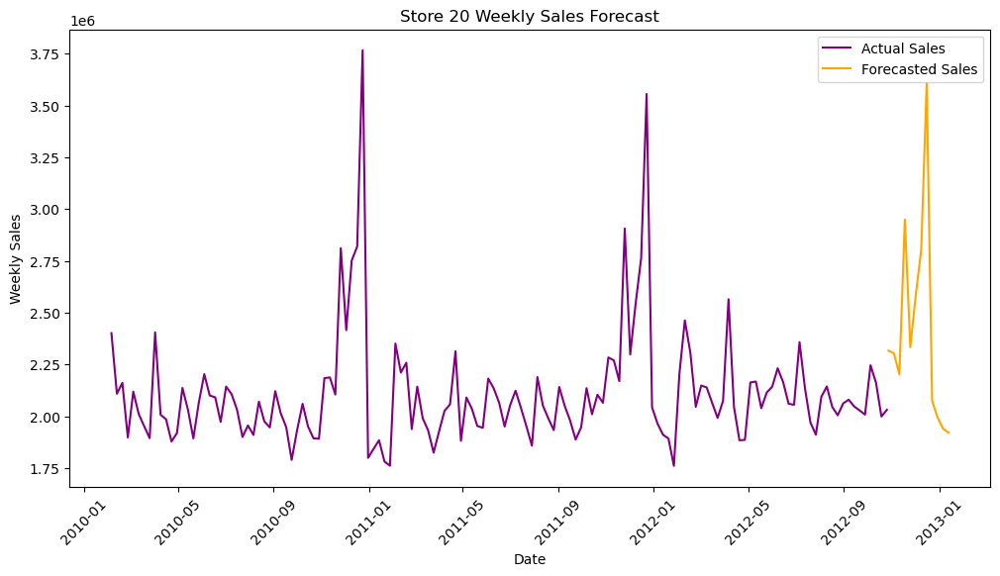

In [20]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Ignore warnings
warnings.filterwarnings('ignore')

forecast_data = pd.DataFrame()
actual_data = pd.DataFrame()

# Filter the data for the specific store (Store 20 in this example)
store_data = df[df['Store'] == 20]
actual_data = store_data[['Date', 'Weekly_Sales']]
actual_data.set_index('Date', inplace=True)  # Set Date as the index

# Create a time series with Weekly Sales as the target variable
time_series = store_data.set_index('Date')['Weekly_Sales']

# Fit the SARIMA model to the time series data
model = SARIMAX(time_series, order=orders[store-1], seasonal_order=(1, 1, 1, 52))
model_fit = model.fit()

# Forecast the sales for the next 12 weeks
forecast_steps = 12
forecast = model_fit.get_forecast(steps=forecast_steps)

# Create a dataframe for the forecast with a date index
forecast_data = pd.DataFrame({'Date': pd.date_range(start=store_data['Date'].iloc[-1], periods= forecast_steps, freq='W'),
                              'Forecasted_Sales': forecast.predicted_mean})
forecast_data.set_index('Date', inplace=True)  # Set Date as the index

# Plot actual and forecasted sales with different colors
plt.figure(figsize=(12, 6))
plt.plot(actual_data.index, actual_data['Weekly_Sales'], label='Actual Sales', color='purple')
plt.plot(forecast_data.index, forecast_data['Forecasted_Sales'], label='Forecasted Sales', color='orange')
plt.title('Store 20 Weekly Sales Forecast')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.show()


In [21]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual and forecasted sales for a single store
actual_sales = store_data['Weekly_Sales'].tail(12)  # Get the last 12 data points
forecasted_sales = forecast_data['Forecasted_Sales']

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(actual_sales, forecasted_sales)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(actual_sales, forecasted_sales)

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)

# Calculate Mean Absolute Percentage Error (MAPE)
mape = np.mean(np.abs((actual_sales - forecasted_sales) / actual_sales)) * 100

print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"MAPE: {mape:.2f}%")


MAE: 432646.43
MSE: 375791077009.88
RMSE: 613018.01
MAPE: nan%


## Predictions

In [33]:
#df['Date'] = pd.to_datetime(df['Date'], format = '%d-%m-%Y')
df.reset_index(inplace=True)

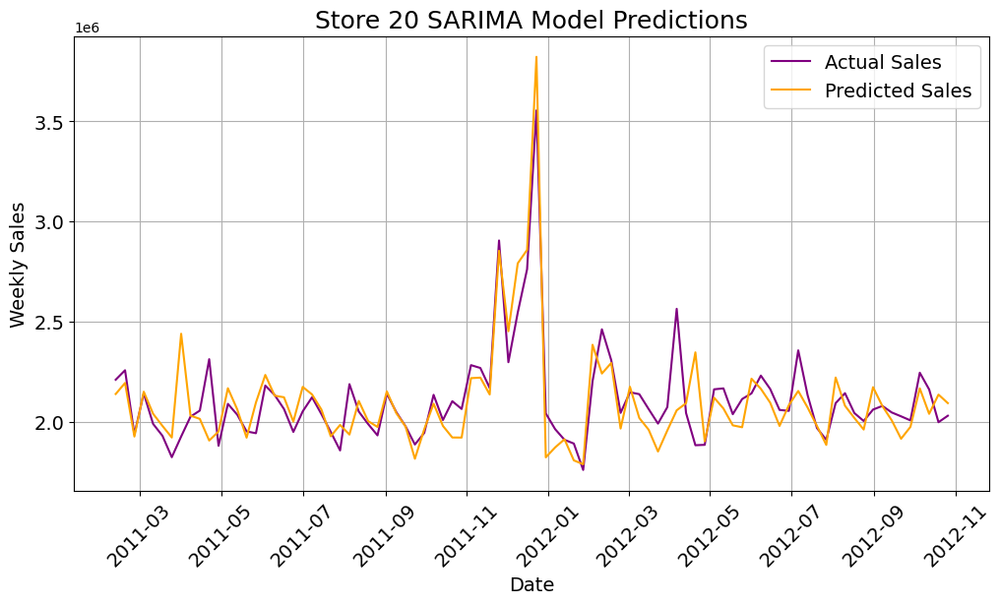

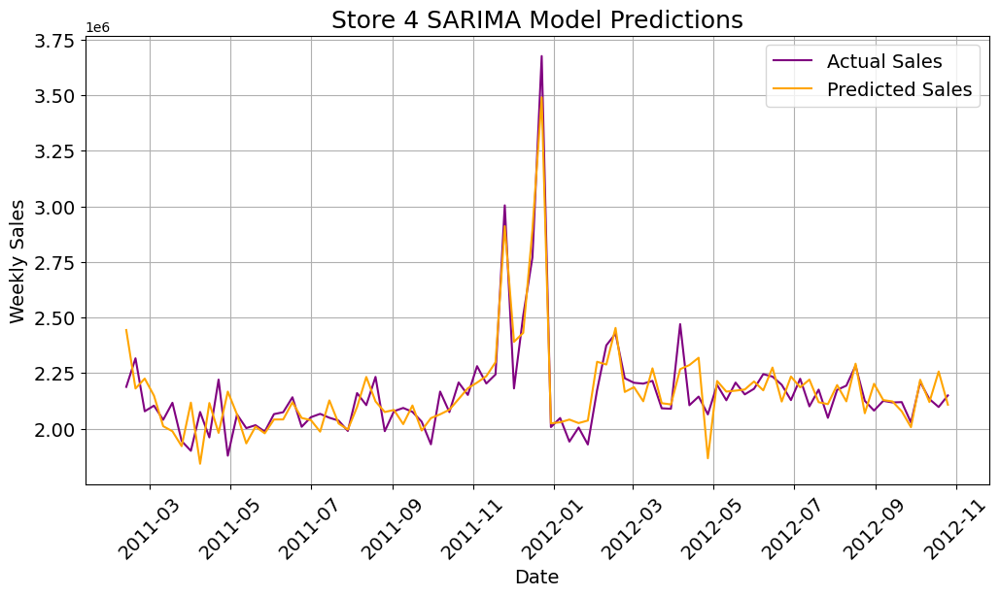

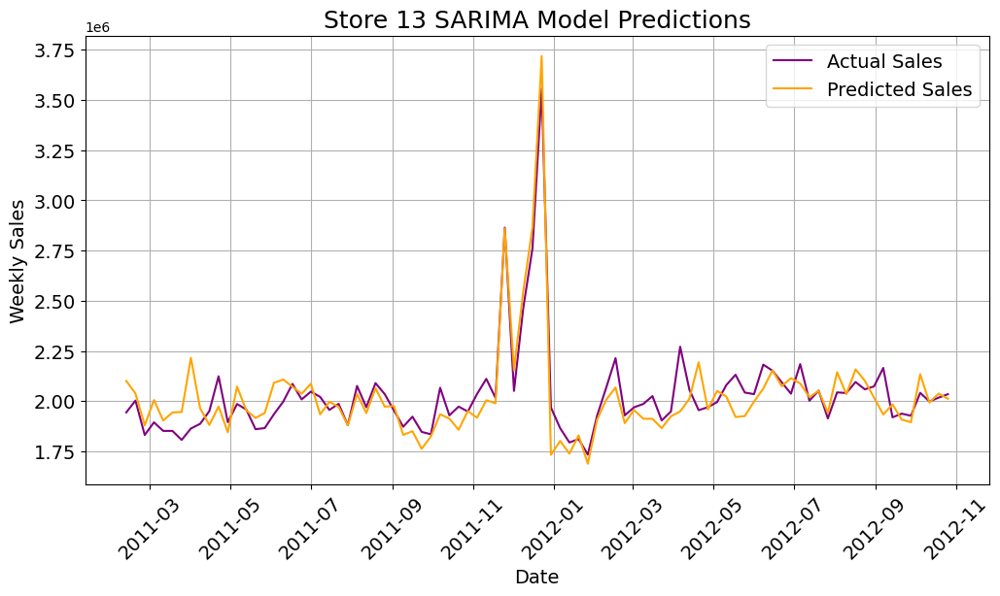

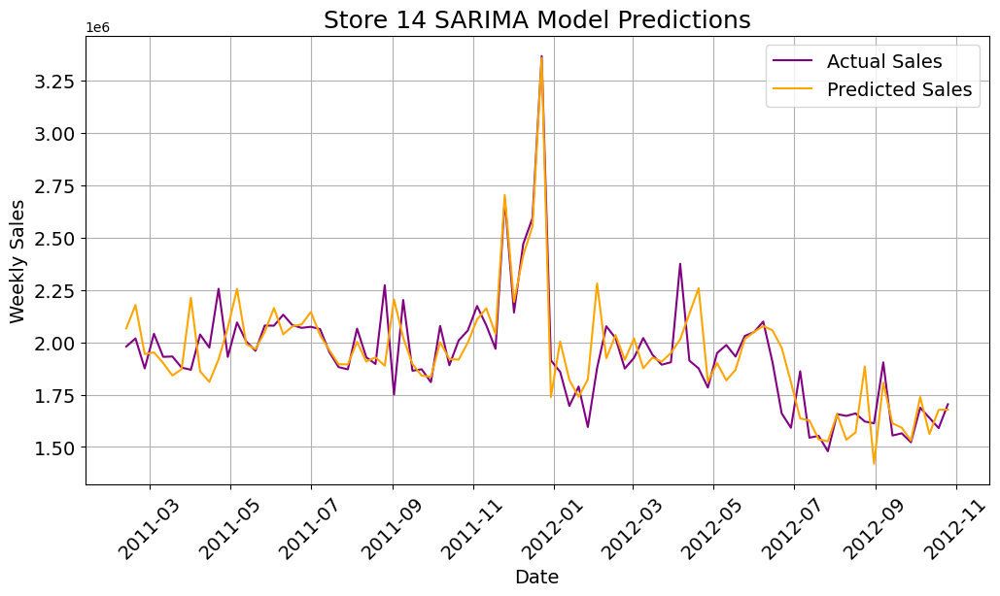

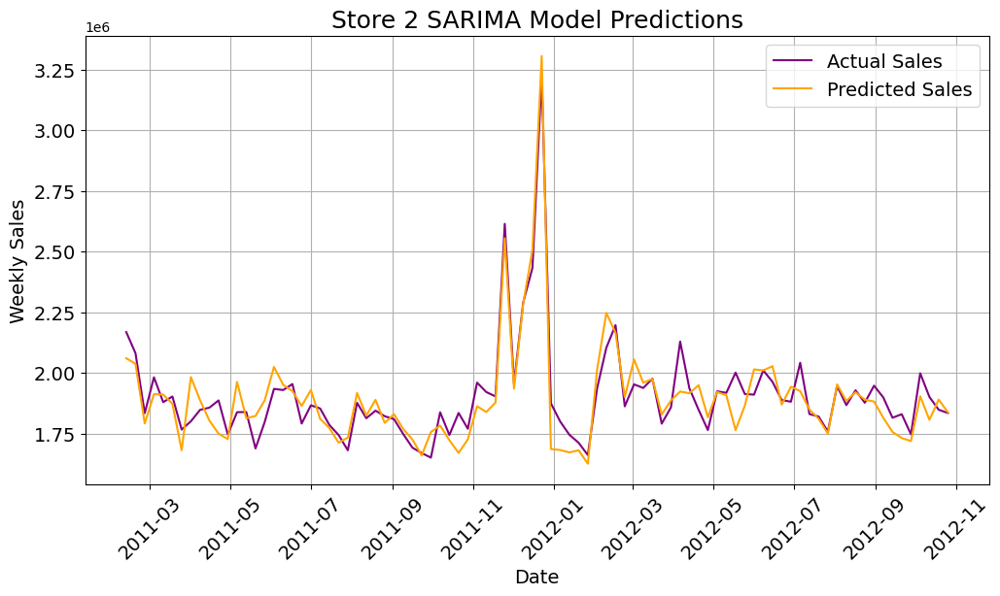

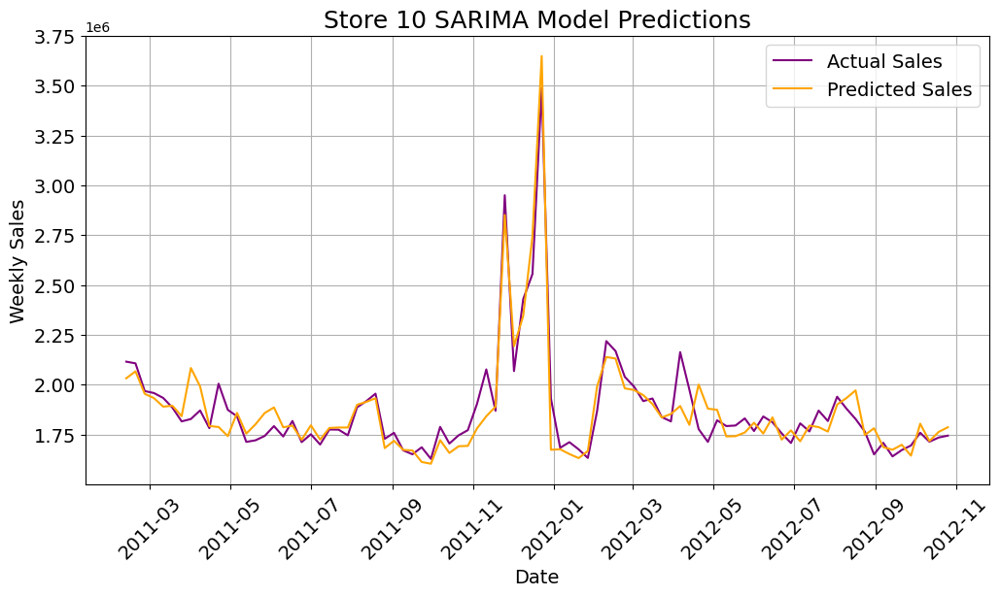

In [23]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Ignore warnings
warnings.filterwarnings('ignore')

predictions_data = pd.DataFrame()
actual_data = pd.DataFrame()
store_numbers = [20, 4, 13, 14, 2, 10]
# Filter the data for the specific store (Store 20 in this example)
for store in store_numbers:
    
    store_data = df[df['Store'] == store]
    actual_data = store_data[['Date', 'Weekly_Sales']]
    actual_data.set_index('Date', inplace=True)  # Set Date as the index

# Create a time series with Weekly Sales as the target variable
    time_series = store_data.set_index('Date')['Weekly_Sales']

# Fit the SARIMA model to the time series data
    model = SARIMAX(time_series, order=orders[store-1], seasonal_order=(1, 1, 1, 52))
    model_fit = model.fit()

# Define the start date from 2011
    start_date = '2011-02-11'

# Get the predictions from 2011 onwards
    predictions = model_fit.get_prediction(start=start_date, end=time_series.index[-1])
    predicted_mean = predictions.predicted_mean

# Create a dataframe for the predictions with a date index
    predictions_data = pd.DataFrame({'Date': predictions.row_labels, 'Predicted_Sales': predicted_mean})
    predictions_data.set_index('Date', inplace=True)  # Set Date as the index

# Plot actual and predicted sales with different colors
    plt.figure(figsize=(12, 6))
    plt.plot(actual_data.loc['2011-02-11':].index,  actual_data.loc['2011-02-11':]['Weekly_Sales'], label='Actual Sales', color='purple')
    plt.plot(predictions_data.index, predictions_data['Predicted_Sales'], label='Predicted Sales', color='orange')
    plt.title(f'Store {store} SARIMA Model Predictions',fontsize=18)
    plt.xlabel('Date',fontsize=14)
    plt.ylabel('Weekly Sales',fontsize=14)
    plt.legend(fontsize=14)
    plt.grid(True)
    plt.xticks(rotation=45,fontsize=14)  # Rotate x-axis labels for readability
    plt.yticks(fontsize=14)
    plt.show()


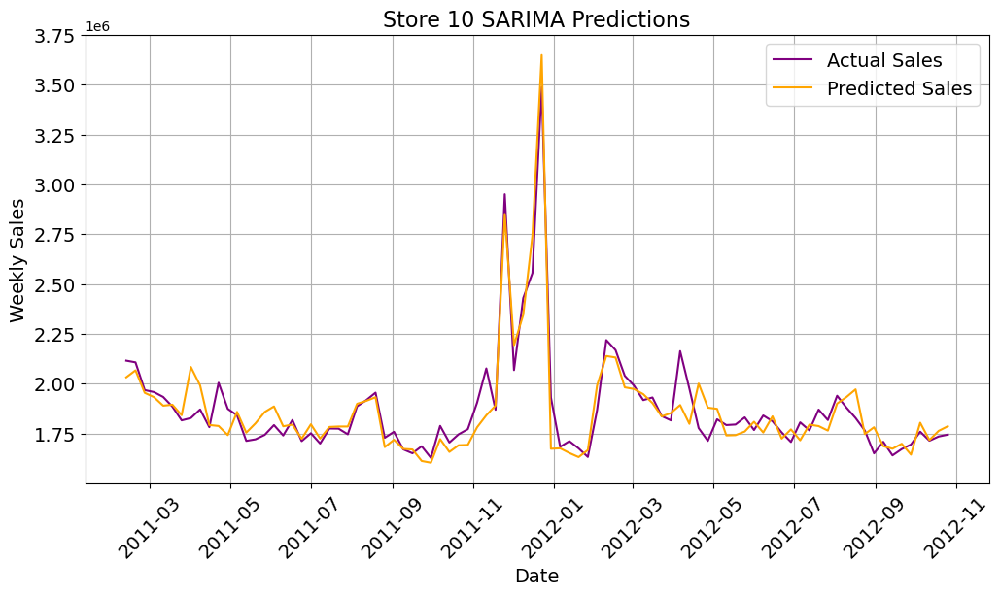

In [42]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Ignore warnings
warnings.filterwarnings('ignore')

predictions_data = pd.DataFrame()
actual_data = pd.DataFrame()
store =   10
# Filter the data for the specific store (Store 20 in this example)

    
store_data = df[df['Store'] == store]
actual_data = store_data[['Date', 'Weekly_Sales']]
actual_data.set_index('Date', inplace=True)  # Set Date as the index

# Create a time series with Weekly Sales as the target variable
time_series = store_data.set_index('Date')['Weekly_Sales']

# Fit the SARIMA model to the time series data
model = SARIMAX(time_series, order=orders[store-1], seasonal_order=(1, 1, 1, 52))
model_fit = model.fit()

# Define the start date from 2011
start_date = '2011-02-11'

# Get the predictions from 2011 onwards
predictions = model_fit.get_prediction(start=start_date, end=time_series.index[-1])
predicted_mean = predictions.predicted_mean

# Create a dataframe for the predictions with a date index
predictions_data = pd.DataFrame({'Date': predictions.row_labels, 'Predicted_Sales': predicted_mean})
predictions_data.set_index('Date', inplace=True)  # Set Date as the index

# Plot actual and predicted sales with different colors
plt.figure(figsize=(12, 6))
plt.plot(actual_data.loc['2011-02-11':].index,  actual_data.loc['2011-02-11':]['Weekly_Sales'], label='Actual Sales', color='purple')
plt.plot(predictions_data.index, predictions_data['Predicted_Sales'], label='Predicted Sales', color='orange')
plt.title(f'Store {store} SARIMA Predictions',fontsize=16)
plt.xlabel('Date',fontsize=14)
plt.ylabel('Weekly Sales',fontsize=14)
plt.legend(fontsize=14)
plt.grid(True)
plt.xticks(rotation=45,fontsize=14)  # Rotate x-axis labels for readability
plt.yticks(fontsize=14)
plt.show()


In [24]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have 'actual_data' and 'predictions_data' for the period from 2011 to the end
actual = actual_data.loc['2011-02-11':]['Weekly_Sales']
predicted = predictions_data['Predicted_Sales']

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(actual, predicted)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(actual, predicted)

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)

# Calculate Mean Absolute Percentage Error (MAPE)
mape = np.mean(np.abs((actual - predicted) / actual)) * 100

# Calculate Mean Error (ME) as a percentage
me_percentage = (np.mean(actual - predicted) / np.mean(actual)) * 100

# Print the evaluation metrics
print(f"Mean Error (ME) Percentage: {me_percentage:.2f}%")
print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")


Mean Error (ME) Percentage: 0.26%
Mean Absolute Error (MAE): 67568.74
Mean Squared Error (MSE): 8542539122.07
Root Mean Squared Error (RMSE): 92425.86
Mean Absolute Percentage Error (MAPE): 3.53%


### Forecast for all 45 stores

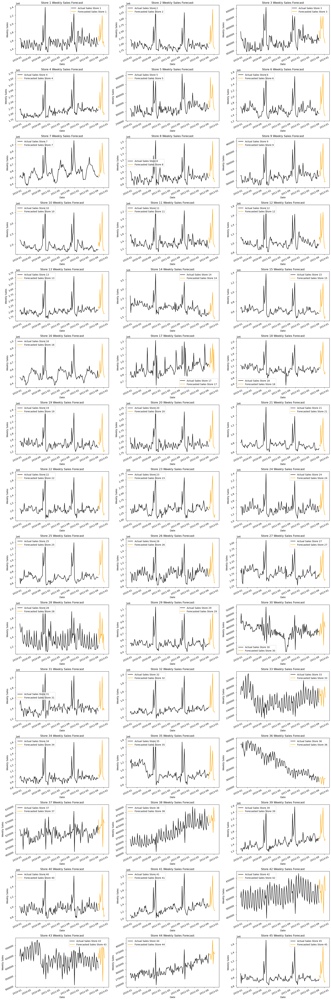

In [44]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
import warnings
import seaborn as sns
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')


# Create a figure and axis for subplots
fig, axes = plt.subplots(15, 3, figsize=(20, 60))

# Flatten the axes array for easier iteration
axes = axes.flatten()
line_colors = ['black', 'orange']

# Define a list of colors for each store
store_colors = sns.color_palette("husl", 45)

# Iterate over each store
for store in range(1, 46):
    # Filter the data for the specific store
    store_data = df[df['Store'] == store]
    actual_data = store_data[['Date', 'Weekly_Sales']]
    actual_data.set_index('Date', inplace=True)  # Set Date as the index

    # Create a time series with Weekly Sales as the target variable
    time_series = store_data.set_index('Date')['Weekly_Sales']

    # Fit the SARIMA model to the time series data
    model = SARIMAX(time_series, order=orders[store-1], seasonal_order=(1, 1, 1, 52))
    model_fit = model.fit()

    # Forecast the sales for the next 12 weeks
    forecast_steps = 12
    forecast = model_fit.get_forecast(steps=forecast_steps)

    # Create a dataframe for the forecast with a date index
    forecast_data = pd.DataFrame({'Date': pd.date_range(start=store_data['Date'].iloc[-1], periods=forecast_steps, freq='W'),
                                  f'Forecasted_Sales_Store_{store}': forecast.predicted_mean})
    forecast_data.set_index('Date', inplace=True)  # Set Date as the index

    # Plot actual and forecasted sales with unique colors on the corresponding subplot
    axes[store-1].plot(actual_data.index, actual_data['Weekly_Sales'], label=f'Actual Sales Store {store}',color=line_colors[0])
    axes[store-1].plot(forecast_data.index, forecast_data[f'Forecasted_Sales_Store_{store}'], label=f'Forecasted Sales Store {store}', color=line_colors[1])
    axes[store-1].set_title(f'Store {store} Weekly Sales Forecast')
    axes[store-1].set_xlabel('Date')
    axes[store-1].set_ylabel('Weekly Sales')
    axes[store-1].legend()
    axes[store-1].tick_params(labelrotation=25)

# Adjust subplot layout

fig.tight_layout(pad=1.2)
plt.show()


In [45]:
#pip install prophet

In [60]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import math


from prophet import Prophet

train_size = int(0.85 * len(df[df['Store']==20]))
test_size = len(df[df['Store']==20]) - train_size

univariate_df = df[df['Store']==20][['Date', 'Weekly_Sales']].copy()
univariate_df.columns = ['ds', 'y']

train = univariate_df.iloc[:train_size, :]

x_train, y_train = pd.DataFrame(univariate_df.iloc[:train_size, 0]), pd.DataFrame(univariate_df.iloc[:train_size, 1])
x_valid, y_valid = pd.DataFrame(univariate_df.iloc[train_size:, 0]), pd.DataFrame(univariate_df.iloc[train_size:, 1])

print(len(train), len(x_valid))

# Train the model
model = Prophet()
model.fit(train)

# x_valid = model.make_future_dataframe(periods=test_size, freq='w')

# Predict on valid set
y_pred = model.predict(x_valid)

# Calcuate metrics
score_mae = mean_absolute_error(y_valid, y_pred.tail(test_size)['yhat'])
score_rmse = math.sqrt(mean_squared_error(y_valid, y_pred.tail(test_size)['yhat']))

print('RMSE: {}'.format(score_rmse))
print('MAE: {}'.format(score_mae))

121 22


10:14:37 - cmdstanpy - INFO - Chain [1] start processing
10:14:37 - cmdstanpy - INFO - Chain [1] done processing


RMSE: 104470.80043757283
MAE: 82242.97419944477


## Regression Models

In [25]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt


In [28]:
df.set_index("Date",inplace=True)

In [29]:
# Define the forecast horizon (number of weeks)
forecast_steps = 130  # Adjust as needed

# Select the specific store number and prepare the target variable (sales)
store_number = 10  # Replace with the store number you're interested in
store_data = df[df['Store'] == store_number]
store_sales = store_data['Weekly_Sales']

# Prepare exogenous variables (features)
exog_features = ['Temperature', 'Unemployment', 'CPI', 'Holiday_Flag', 'Fuel_Price']
store_exog = store_data[exog_features]

forecast_start_date = pd.to_datetime('2011-02-11')  # Adjust the date as needed

# Split the data into training and testing sets with the desired start date
X_train = store_exog[store_exog.index < forecast_start_date]
y_train = store_sales[store_sales.index < forecast_start_date]

X_test = store_exog[(store_exog.index >= forecast_start_date) & (store_exog.index < forecast_start_date + pd.DateOffset(weeks=forecast_steps))]
y_test = store_sales[(store_sales.index >= forecast_start_date) & (store_sales.index < forecast_start_date + pd.DateOffset(weeks=forecast_steps))]

# Split the data into training and testing sets
#X_train, X_test = store_exog[:-forecast_steps], store_exog[-forecast_steps:]
#y_train, y_test = store_sales[:-forecast_steps], store_sales[-forecast_steps:]

# Continue with the modeling and forecasting steps as shown in the previous code example.



In [30]:
linear_reg = LinearRegression()
rf_regressor = RandomForestRegressor()
gb_regressor = GradientBoostingRegressor()

linear_reg.fit(X_train, y_train)
rf_regressor.fit(X_train, y_train)
gb_regressor.fit(X_train, y_train)

# Make predictions for the forecast period
linear_reg_forecast = linear_reg.predict(X_test)
rf_forecast = rf_regressor.predict(X_test)
gb_forecast = gb_regressor.predict(X_test)



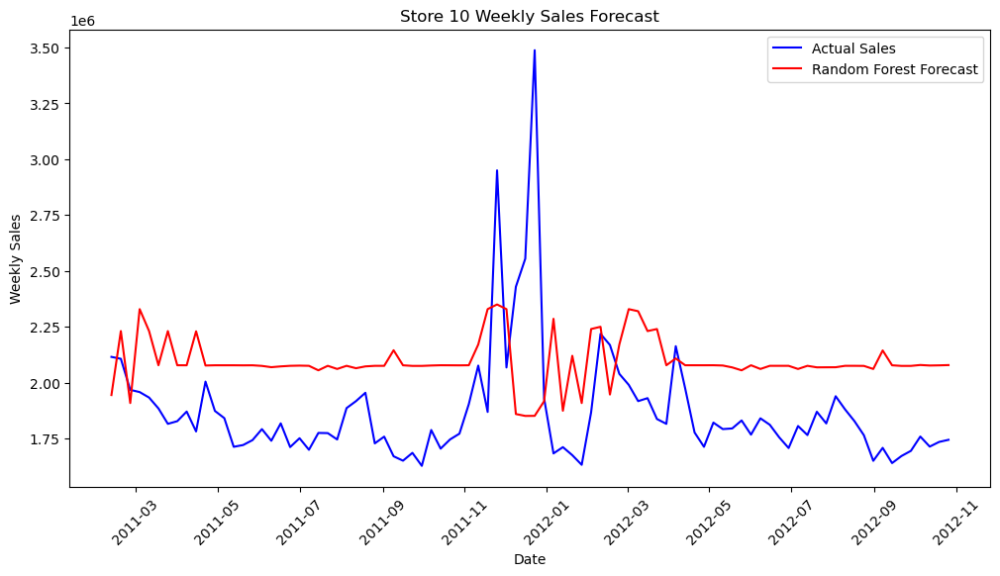

In [31]:
# Visualize the forecasts
plt.figure(figsize=(12, 6))
plt.plot(y_test.index, y_test.values, label='Actual Sales', color='blue')
#plt.plot(y_test.index, linear_reg_forecast, label='Linear Regression Forecast', color='green')
plt.plot(y_test.index, rf_forecast, label='Random Forest Forecast', color='red')
#plt.plot(y_test.index, gb_forecast, label='Gradient Boosting Forecast', color='purple')
plt.title(f'Store {store_number} Weekly Sales Forecast')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.legend()
plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.show()

### Regression Models Prediction

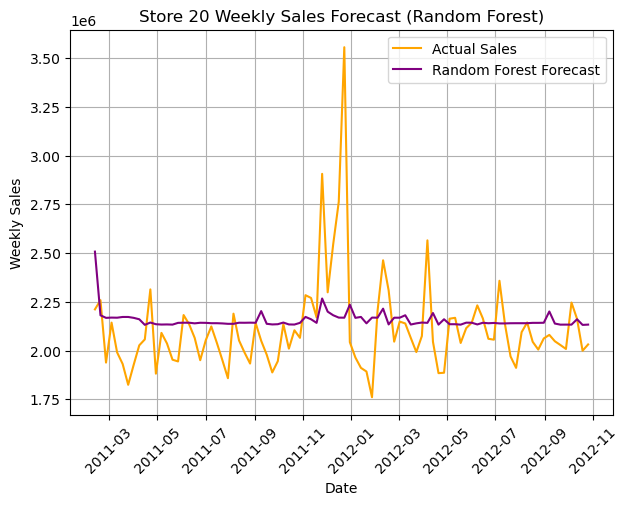

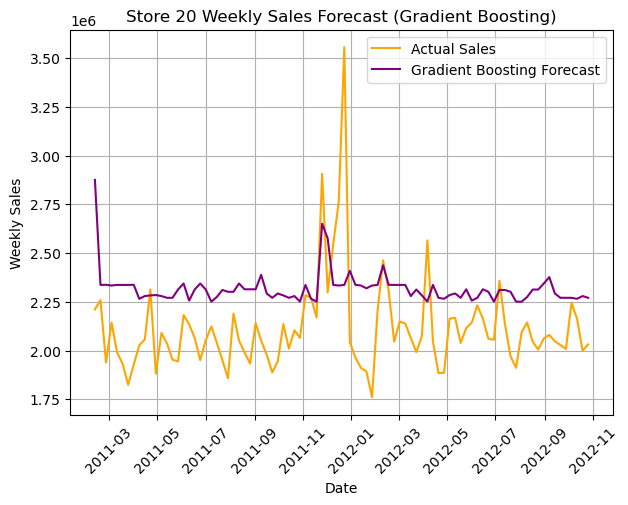

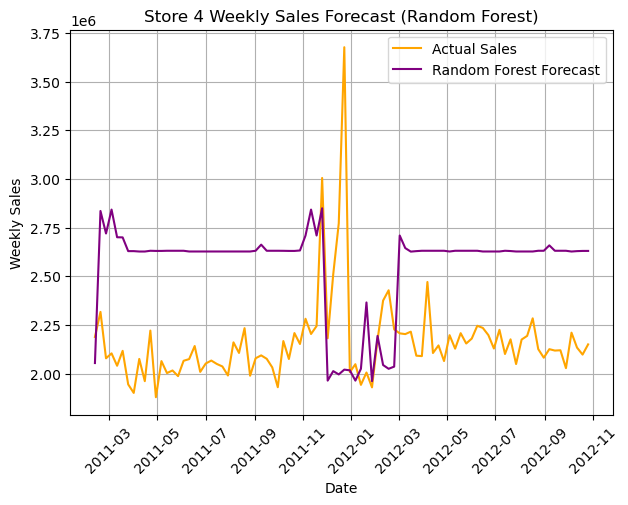

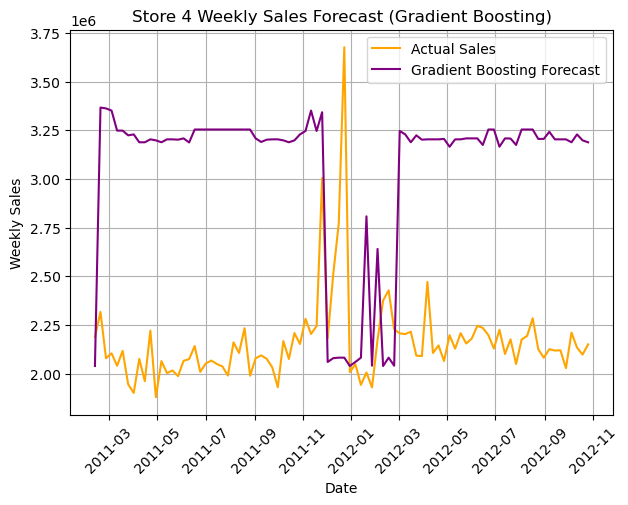

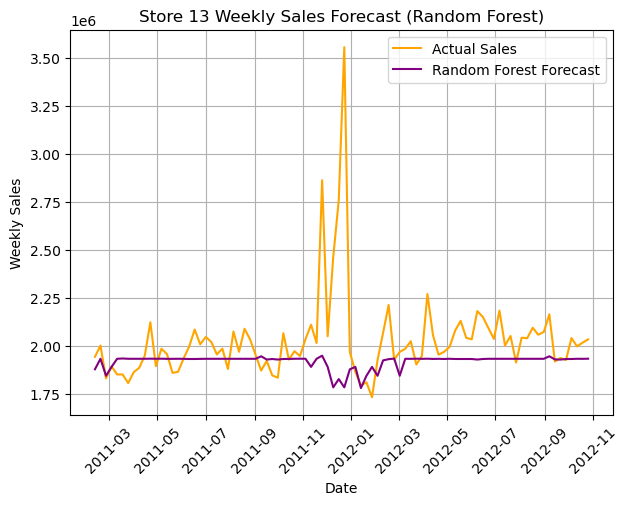

...

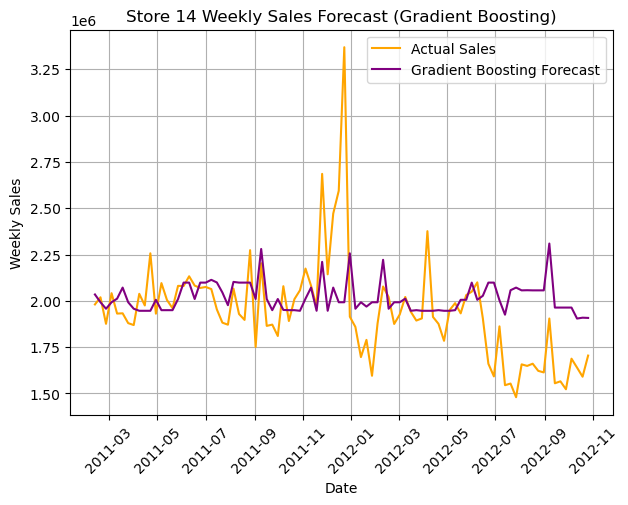

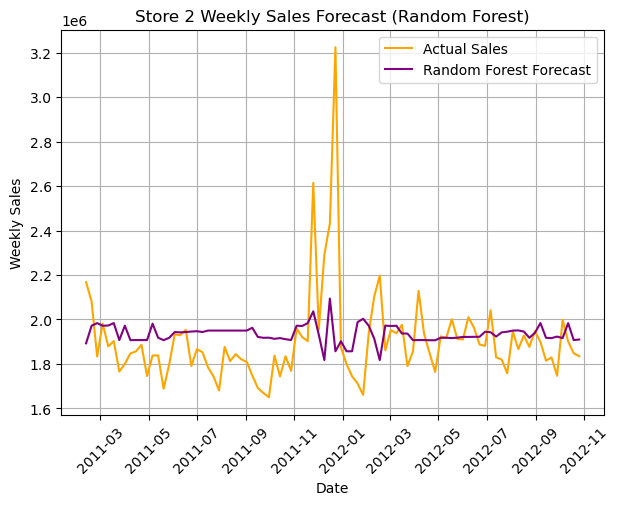

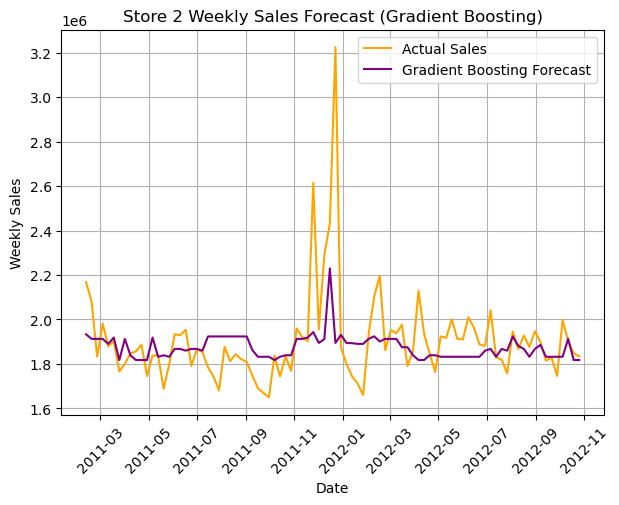

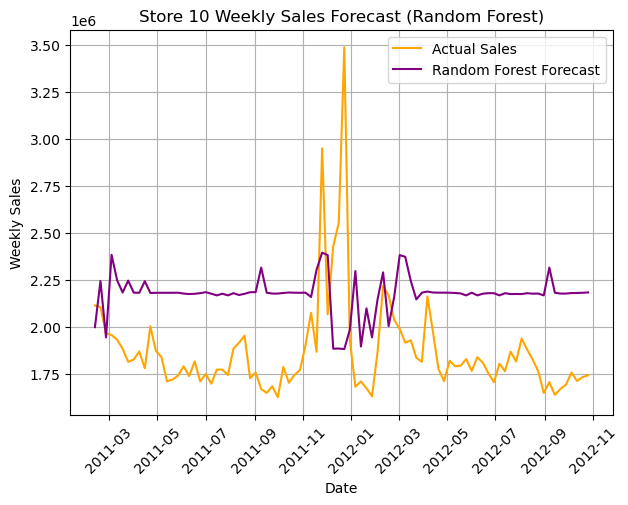

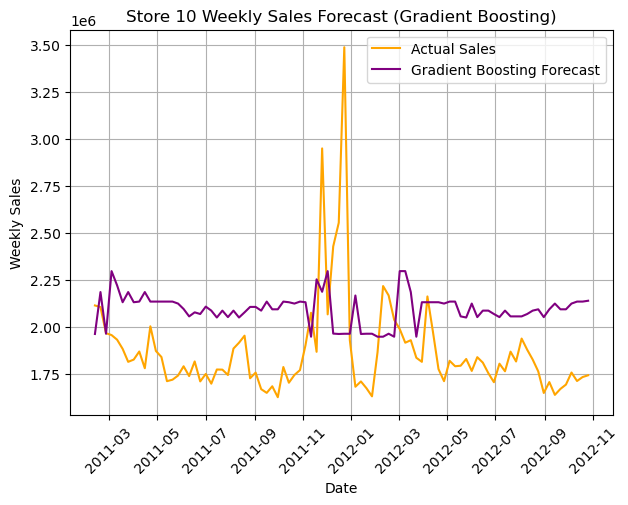

In [24]:


# Define the forecast horizon (number of weeks)
forecast_steps = 130  # Adjust as needed

# Select the specific store numbers you're interested in
store_numbers = [20, 4, 13, 14, 2, 10]
exog_features = ['Temperature', 'Unemployment', 'CPI', 'Holiday_Flag', 'Fuel_Price']
forecast_start_date = pd.to_datetime('2011-02-11')

# Create separate plots for each store
for store_number in store_numbers:
    # Select data for the current store
    store_exog = store_data[exog_features]

    
    store_data = df[df['Store'] == store_number]
    store_sales = store_data['Weekly_Sales']
    store_exog = store_data[exog_features]

    # Split the data into training and testing sets with the desired start date
    X_train = store_exog[store_exog.index < forecast_start_date]
    y_train = store_sales[store_sales.index < forecast_start_date]

    X_test = store_exog[(store_exog.index >= forecast_start_date) & (store_exog.index < forecast_start_date + pd.DateOffset(weeks=forecast_steps))]
    y_test = store_sales[(store_sales.index >= forecast_start_date) & (store_sales.index < forecast_start_date + pd.DateOffset(weeks=forecast_steps))]

    # Initialize and train your regression models
    linear_reg = LinearRegression()
    rf_regressor = RandomForestRegressor()
    gb_regressor = GradientBoostingRegressor()

    linear_reg.fit(X_train, y_train)
    rf_regressor.fit(X_train, y_train)
    gb_regressor.fit(X_train, y_train)

    # Make predictions for the forecast period
    linear_reg_forecast = linear_reg.predict(X_test)
    rf_forecast = rf_regressor.predict(X_test)
    gb_forecast = gb_regressor.predict(X_test)

    # Plot actual sales and forecasts for each model in separate plots
   
    plt.figure(figsize=(7, 5))
    plt.plot(y_test.index, y_test.values, label='Actual Sales', color='orange')
    plt.plot(y_test.index, rf_forecast, label='Random Forest Forecast', color='purple')
    plt.title(f'Store {store_number} Weekly Sales Forecast (Random Forest)')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.show()
    print()

    plt.figure(figsize=(7, 5))
    plt.plot(y_test.index, y_test.values, label='Actual Sales', color='orange')
    plt.plot(y_test.index, gb_forecast, label='Gradient Boosting Forecast', color='purple')
    plt.title(f'Store {store_number} Weekly Sales Forecast (Gradient Boosting)')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.show()
    print()


In [32]:


# Calculate evaluation metrics for Linear Regression
linear_reg_mae = mean_absolute_error(y_test, linear_reg_forecast)
linear_reg_rmse = mean_squared_error(y_test, linear_reg_forecast, squared=False)

# Calculate evaluation metrics for Random Forest
rf_mae = mean_absolute_error(y_test, rf_forecast)
rf_rmse = mean_squared_error(y_test, rf_forecast, squared=False)

# Calculate evaluation metrics for Gradient Boosting
gb_mae = mean_absolute_error(y_test, gb_forecast)
gb_rmse = mean_squared_error(y_test, gb_forecast, squared=False)

# Print the evaluation metrics
print("Linear Regression Metrics:")
print(f"Mean Absolute Error (MAE): {linear_reg_mae:.2f}")
print(f"Root Mean Squared Error (RMSE): {linear_reg_rmse:.2f}")

print()

print("Random Forest Metrics:")
print(f"Mean Absolute Error (MAE): {rf_mae:.2f}")
print(f"Root Mean Squared Error (RMSE): {rf_rmse:.2f}")

print()

print("Gradient Boosting Metrics:")
print(f"Mean Absolute Error (MAE): {gb_mae:.2f}")
print(f"Root Mean Squared Error (RMSE): {gb_rmse:.2f}")

print()


Linear Regression Metrics:
Mean Absolute Error (MAE): 609110.65
Root Mean Squared Error (RMSE): 690292.75

Random Forest Metrics:
Mean Absolute Error (MAE): 313611.00
Root Mean Squared Error (RMSE): 365886.51

Gradient Boosting Metrics:
Mean Absolute Error (MAE): 315376.36
Root Mean Squared Error (RMSE): 362216.10

